# Домашняя работа 1
## В данном задании мы будем сжимать звуковую дорожку при помощи алгоритма PCA

In [ ]:
# Понадобится для чтения и записи аудио файлов
from scipy.io import wavfile

# Это нужно для проигрывания аудио файлов прямо в блокноте
from IPython.display import Audio

# А это набор для этого задания
import numpy as np
import matplotlib.pyplot as plt
from sklearn.decomposition import PCA

In [ ]:
# Скачаем данные
! wget https://www.dropbox.com/s/p5147nr8mzemxnr/Beethoven_Violin_Sonata_Op_96_first_movement_bars_1-22.wav

--2023-08-22 13:26:14--  https://www.dropbox.com/s/p5147nr8mzemxnr/Beethoven_Violin_Sonata_Op_96_first_movement_bars_1-22.wav
Resolving www.dropbox.com (www.dropbox.com)... 162.125.80.18, 2620:100:6035:18::a27d:5512
Connecting to www.dropbox.com (www.dropbox.com)|162.125.80.18|:443... connected.
HTTP request sent, awaiting response... 302 Found
Location: /s/raw/p5147nr8mzemxnr/Beethoven_Violin_Sonata_Op_96_first_movement_bars_1-22.wav [following]
--2023-08-22 13:26:15--  https://www.dropbox.com/s/raw/p5147nr8mzemxnr/Beethoven_Violin_Sonata_Op_96_first_movement_bars_1-22.wav
Reusing existing connection to www.dropbox.com:443.
HTTP request sent, awaiting response... 302 Found
Location: https://uc7cf92b2b11710b36f0e254669d.dl.dropboxusercontent.com/cd/0/inline/CCTtGpZrbwDsqo9fVTSpO1rHju17cfhjKbC6fjXfJuos8x8lj9bYRETz9sWbX_3ppbr-NEWK3u8fOj1kAgnbvAbzyofaRzkUCsiI9VfpsPANfdoDQCUR2T5ZWeSs46v0UJsopGz-5V98AMMOnHds-2FA/file# [following]
--2023-08-22 13:26:16--  https://uc7cf92b2b11710b36f0e254669d

In [ ]:
# Прочитаем аудио дорожку при помощи wavfile
samplerate, data = wavfile.read('Beethoven_Violin_Sonata_Op_96_first_movement_bars_1-22.wav')

`samplerate` есть частота дискретизации - стандартное для аудио значние -- 44100 Гц.

NOTE: **Частота дискретизации** говорит о том, сколько последовательных элементов массива с сигналом кодируют звук длительностью 1 секунда.

Подробнее о кодировании звука [тут](https://ru.wikipedia.org/wiki/Кодирование_звуковой_информации).

In [ ]:
# Посмотрим какая у нас частота диспретезации
print(samplerate)

44100


In [ ]:
# Если поделить длину массива сигнала на samplerate, получится длительность аудиодорожки в секундах

print(len(data) / samplerate)

# 45 секунд - похоже на правду:)

45.139591836734695


In [ ]:
# Заметим, что звук - стерео, так как сигнал кодируется двумя каналами (для левого и правого динамика):

print(data.shape)

(1990656, 2)


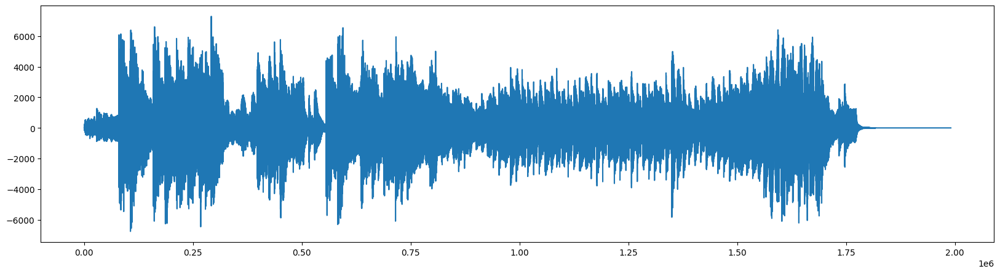

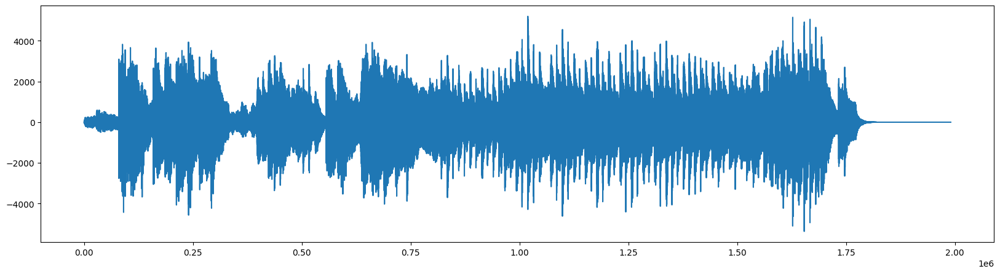

In [ ]:
# Отрисуем сигналы в обоих каналах

# Канал 1
plt.figure(figsize=(20,5))
plt.plot(data[:,0])
plt.show()

# Канал 2
plt.figure(figsize=(20,5))
plt.plot(data[:,1])
plt.show()

In [ ]:
# Усредним каналы, и получим моно звук, с которым будет проще работать

mono_sound = np.mean(data, axis=1)
print(mono_sound.shape)

(1990656,)


In [ ]:
# Давайте послушаем наконец, что же мы будем сжимать:)

Audio(mono_sound, rate = samplerate)

In [ ]:
# Для удобства - обрежем массив с сигналом так, чтобы его было удобнее делить на равные части, датасет из которых и необходимо будет сжать известными вам методами.
# На самом деле способ очень похож на тот, которым мы сжимали картинку, деля её на прямоугольные подкартинки, только здесь задача еще проще)

mono_sound_to_cut = mono_sound[:1990000]

In [ ]:
# Проверим, что наш звук теперь это просто вектор числел

print(mono_sound_to_cut.shape)

(1990000,)


#### Задание 1:

**Подсказка:** В это задании нужно всего лишь вспомнить как пользоваться методом `.reshape()`


1. Разделите сигнал на равные части (длину каждой части возьмите равной 1000) и соберите из них "датасет", который будет представлять из себя двухменый массив - "матрицу", в которой каждая часть сигнала длины 1000 находится в отдельной строке).

    То есть первая часть содержит первые 1000 чисел сигнала и находится в первой строке матрицы, вторая часть следующие 1000 чисел сигнала и находится во второй строке матрицы и так далее.

    Это также как мы делали с кусочками картинки и получали матрицу размера `(24, 1152000)`!

In [ ]:
segment_length = 1000
num_segments = len(mono_sound_to_cut) // segment_length

# Создаем пустую матрицу, в которой будем хранить сегменты сигнала
signal_matrix = np.empty((num_segments, segment_length))

# Заполняем матрицу сегментами сигнала
for i in range(num_segments):
    start_idx = i * segment_length
    end_idx = start_idx + segment_length
    signal_matrix[i, :] = mono_sound_to_cut[start_idx:end_idx]

2. Напишите функцию, которая будет переводить вашу "матрицу" обратно в звуковой сигнал, то есть разворачивать данные обратно из матрицы размера `(число объектов, 1000)` в вектор длины `(число объектов * 1000)`. Проверьте, что все работает верно, путем воспроизведения "востановленного" сигнала -- он должен совпасть в точности с изначальным (ведь им на самом деле и является).

In [ ]:
len(signal_matrix)

1990

In [ ]:
#n
#PCA(n_components=n - 1)

def matrix_to_signal(matrix):
    num_segments, segment_length = matrix.shape

    # Создаем пустой вектор для восстановленного сигнала
    reconstructed_signal = np.empty(num_segments * segment_length)

    # Заполняем вектор восстановленным сигналом из матрицы
    for i in range(num_segments):
        start_idx = i * segment_length
        end_idx = start_idx + segment_length
        reconstructed_signal[start_idx:end_idx] = matrix[i, :]

    return reconstructed_signal


In [ ]:
reconstructed_signal = matrix_to_signal(signal_matrix)

# Проверим, что восстановленный сигнал совпадает с изначальным
print(np.allclose(mono_sound_to_cut, reconstructed_signal))

# Воспроизведем восстановленный сигнал
Audio(reconstructed_signal, rate=samplerate)

True


#### Задание 2

Подсказка: код этого пункта практически полностью совпадает с кодом, который мы использовали на семинаре.

1. Выполните PCA преобразование нашей матрицы, и получите данные, сжатые в пространство меньшей размерности.

    На этом этапе у нас есть наш "датасет" с 1000 "признаками" и мы хотим уменьшить число "признаков" путем применения метода PCA. Число компонент предлагается выбрать вам, но для начала не стоит брать слишком маленькое число, чтобы потом было проще понять, в случае плохого результата -- компонент оказалось недостаточно или вы где-то ошиблись:)


In [ ]:
# Создаем экземпляр PCA с заданным числом компонент (например, 100)
num_components = 100
pca = PCA(n_components=num_components)

# Применяем PCA на матрицу сегментов
compressed_matrix = pca.fit_transform(signal_matrix)

# Выведем объясненную дисперсию для каждой компоненты
explained_variance = pca.explained_variance_ratio_
print("Explained Variance for each component:", explained_variance)

# Восстановим данные обратно
reconstructed_matrix = pca.inverse_transform(compressed_matrix)

# Воспроизведем восстановленный сигнал
reconstructed_signal_pca = matrix_to_signal(reconstructed_matrix)
Audio(reconstructed_signal_pca, rate=samplerate)


Explained Variance for each component: [0.05682279 0.05589755 0.04527993 0.04364599 0.04182063 0.0396966
 0.03927264 0.03662631 0.03502952 0.03276885 0.0322067  0.03106737
 0.02955125 0.02886008 0.02733005 0.02644493 0.02509015 0.02426608
 0.02213717 0.02195951 0.02085922 0.02005941 0.01948115 0.01901049
 0.01776063 0.01630752 0.01326911 0.0117563  0.011206   0.01043085
 0.00880632 0.00848119 0.00726173 0.00564118 0.00520039 0.00506118
 0.00491579 0.00458111 0.00449102 0.00427365 0.00418073 0.00404704
 0.0037711  0.00335096 0.00328799 0.00314434 0.00285816 0.00275322
 0.00254367 0.00243236 0.00232076 0.00231081 0.00222529 0.00186998
 0.00183422 0.00178319 0.00165135 0.00156181 0.00147988 0.00143421
 0.00141079 0.00135541 0.00125298 0.00117605 0.0010578  0.00098524
 0.00097754 0.00096205 0.00094138 0.0009267  0.0008717  0.00079992
 0.00078383 0.00075675 0.00073723 0.0006847  0.00064233 0.00061906
 0.00059968 0.00057423 0.00053425 0.00052232 0.00051685 0.00049303
 0.00048744 0.00046209 0


2. Постройте сами две главные компоненты в наглядной форме. Сделайте выводы исходя из их вида.

    То есть необходимо применить метод PCA к нашей матрице с числом компонент, равным 2 (тем самым получив датасет с 2 "признаками"). Это позволит нам отрисовать данные на плоскости, чтобы попытаться уловить зависимости.

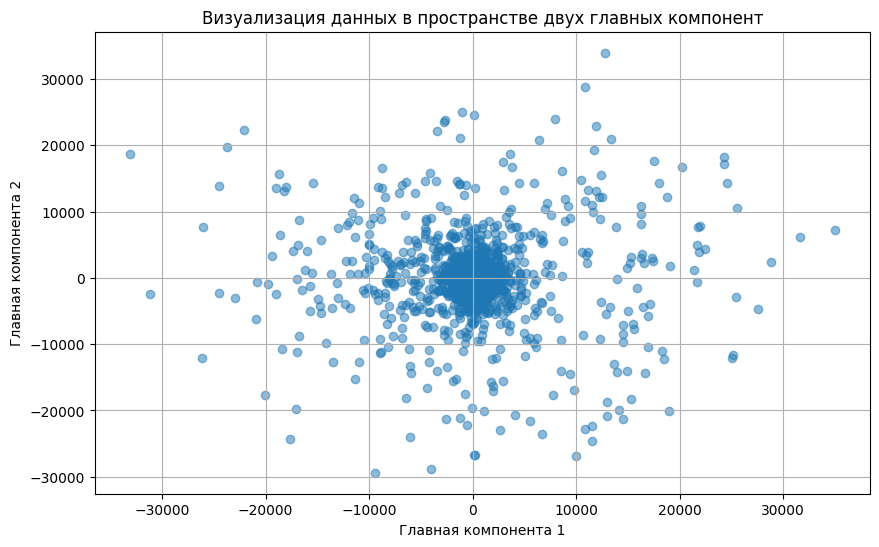

In [ ]:
# Создаем экземпляр PCA с двумя компонентами
pca_2d = PCA(n_components=2)

# Применяем PCA на матрицу сегментов
compressed_matrix_2d = pca_2d.fit_transform(signal_matrix)

# Визуализируем данные на плоскости
plt.figure(figsize=(10, 6))
plt.scatter(compressed_matrix_2d[:, 0], compressed_matrix_2d[:, 1], alpha=0.5)
plt.xlabel('Главная компонента 1')
plt.ylabel('Главная компонента 2')
plt.title('Визуализация данных в пространстве двух главных компонент')
plt.grid(True)
plt.show()

*3*. Постройте scatter plot датасета в пространстве первых двух компонент, а третью используйте как цвет.
    То есть необходимо применить метод PCA уже с 3 компонентами и нарисовать опять точки, только передав третью компоненту в качестве цвета. (мы также делали на семинаре с картинкой)

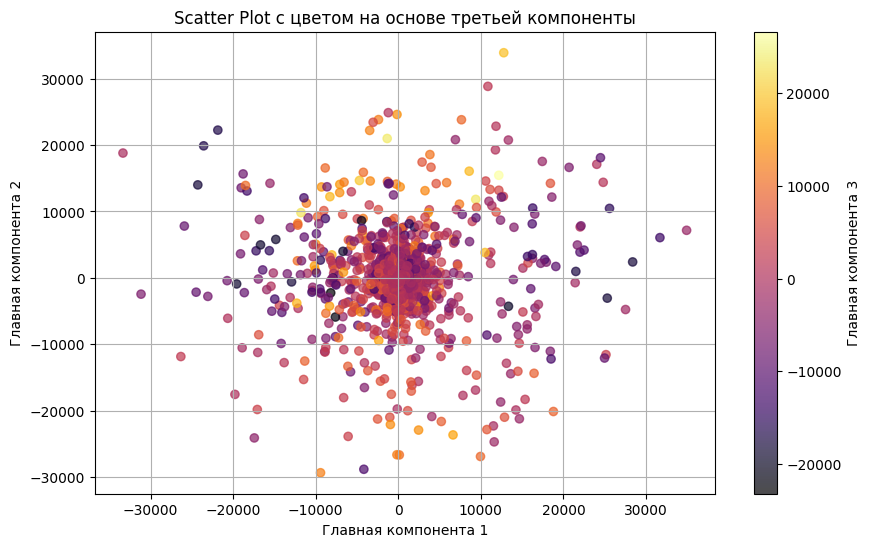

In [ ]:
# Создаем экземпляр PCA с тремя компонентами
pca_3d = PCA(n_components=3)

# Применяем PCA на матрицу сегментов
compressed_matrix_3d = pca_3d.fit_transform(signal_matrix)

# Получаем первые две главные компоненты
component_1_3d = compressed_matrix_3d[:, 0]
component_2_3d = compressed_matrix_3d[:, 1]

# Получаем третью главную компоненту для использования в качестве цвета
component_3_3d = compressed_matrix_3d[:, 2]

# Визуализируем данные на плоскости, используя третью компоненту как цвет
plt.figure(figsize=(10, 6))
plt.scatter(component_1_3d, component_2_3d, c=component_3_3d, cmap='inferno', alpha=0.7)
plt.xlabel('Главная компонента 1')
plt.ylabel('Главная компонента 2')
plt.title('Scatter Plot с цветом на основе третьей компоненты')
plt.colorbar(label='Главная компонента 3')
plt.grid(True)
plt.show()


#### Задание 3

Нам осталось заняться непосредственно "сжатием" звука и проверкой правильности наших действий.

1. Выполните обратное PCA преобразование сжатых данных и получите "матрицу" с сжатым звуком.

    Воспользуйтесь обратным преобразованием PCA (inverse_transform), чтобы из матрицы размера `(число объектов, число компонент)` перейти в матрицу размера `(число объектов, 1000)`.

In [ ]:
# Применяем обратное PCA преобразование для получения сжатого звука
reconstructed_matrix_3d = pca_3d.inverse_transform(compressed_matrix_3d)
print(compressed_matrix_3d.shape)
print(reconstructed_matrix_3d.shape)


(1990, 3)
(1990, 1000)


2. Преобразуйте "матрицу", получившуюся обратным преобразованием, в сигнал (одномерный массив, наш "сжатый" монозвук), и послушайте результат `(Audio(YOUR_RESULT, rate = samplerate)`.

    Воспользуйтесь функцией, которую написали в первом задании, чтобы преобразовать матрицу с "сжатым" звуком (размер после обратного преобразования должен быть такой же, как и у оригинальной матрицы) в вектор-сигнал, который уже можно будет прослушать. Если звук похож на оригинал, то вы все сделали правильно!

In [ ]:
# Преобразуем восстановленную матрицу обратно в сигнал
reconstructed_signal_final = matrix_to_signal(reconstructed_matrix_3d)

# Воспроизведем сжатый звук
Audio(reconstructed_signal_final, rate=samplerate)

3. Исследуйте зависимость качества звука от числа компонент. Подберите "на слух" минимальное число компонент, при котором звук практически не отличается от оригинала.

Добавьте в ячейки два варианта звуковой дорожки -- оригинальную и выбранную вами. Укажите какое число компонент вы оставили.



Подсказка! попробуйте отфильтровать сигнал с помощью функции `gaussian_filter1d` из `scipy.ndimage`. Это поможет убрать неприятный дробовой шум при сильном сжатии

Пример кода для фильтрации - `Audio(gaussian_filter1d(mono_sound_compressed, 2), rate = samplerate)`

In [ ]:
from scipy.ndimage import gaussian_filter1d

# Сжимаем и восстанавливаем сигнал с разным числом компонент
num_components_list = [10, 20, 30, 40, 50, 60, 70, 80, 90, 100]
reconstructed_signals = []

for num_components in num_components_list:
    pca = PCA(n_components=num_components)
    compressed_matrix = pca.fit_transform(signal_matrix)
    reconstructed_matrix = pca.inverse_transform(compressed_matrix)
    reconstructed_signal = matrix_to_signal(reconstructed_matrix)
    reconstructed_signals.append(reconstructed_signal)

# Воспроизведение оригинального и восстановленных звуков с разным числом компонент
print("Оригинальный сигнал:")
Audio(mono_sound_to_cut, rate=samplerate)


Оригинальный сигнал:


In [ ]:
#восстанавливаем сигнал c числом компонент = 50
filtered_reconstructed_signal = gaussian_filter1d(reconstructed_signals[4], 2)
Audio(filtered_reconstructed_signal, rate=samplerate)


3.1   Ответьте на вопросы:
- Количество компонент, которое вы выбрали это много или мало?
- Как сильно можно сжать звук таким образом?
- А если нам дадут другую звуковую дорожку, нам надо сделать то же самое, чтобы сжать звук, как автоматически подобрать число компонент и возможно ли это?

 Количество компонент, которое я выбрал (50), зависит от задачи и требований к качеству звука. В данном случае, мо экспериментировать с разными значениями числа компонент и слушать, насколько качество сжатого звука отличается от оригинала. Важно найти баланс между сжатием и сохранением качества. В данном случае я ориентировался на свой очень плохой слух. (у меня инвалидность по слуху)

 В зависимости от конкретного сигнала и требований к качеству, можно сжать звук в разной степени. Сильное сжатие может привести к потере некоторых деталей и нюансов звука, что может сделать его менее приятным для прослушивания.

 Для другой звуковой дорожки можно применить тот же подход, однако оптимальное число компонент может различаться в зависимости от характера звука. Автоматически подобрать число компонент можно с помощью методов, таких как метод локтя (elbow method) или критерий объясненной дисперсии. Эти методы позволяют определить оптимальное число компонент, которое объясняет большую часть изменчивости данных, но не вносит слишком большую потерю информации.


In [ ]:
# Ваше решение здесь

4. (доп задание)

  a) Оберните получившийся код по сжатию звука в одну или несколько функций

  b) Проведите исследование того, как степень сжатия (соотношения размера частей, на которые делился сигнал в задании 1.1 к размеру пространсва, в которое вы сжимали данные с помощью PCA) влияет на звук, по субъективным ощущениям. Начиная с какой степени сжания сильно слышится потеря качества? (как с учетом фильтрации с помощью gaussian_filter1d, так и без неё)

  d) Что степень сжатия означает для PCA? Для большой аудиозаписи (3 мин, например) мы хотели бы разбить на большее, меньшее или такое же число отрезков как и для предложенной аудиозаписи? Почему?

  c) Можно ли как-то автоматически подобрать степерь сжатия? За что она отвечает в нашей задаче. Как степень сжатия влияет на звук? Почему она так влияет на звук?



In [ ]:
def compress_audio(signal, segment_length, num_components):
    num_segments = len(signal) // segment_length
    signal_matrix = np.empty((num_segments, segment_length))

    for i in range(num_segments):
        start_idx = i * segment_length
        end_idx = start_idx + segment_length
        signal_matrix[i, :] = signal[start_idx:end_idx]

    pca = PCA(n_components=num_components)
    compressed_matrix = pca.fit_transform(signal_matrix)
    return compressed_matrix, pca

def reconstruct_audio(compressed_matrix, pca):
    reconstructed_matrix = pca.inverse_transform(compressed_matrix)
    reconstructed_signal = matrix_to_signal(reconstructed_matrix)
    return reconstructed_signal

In [ ]:
test_audio_compress, pca = compress_audio(mono_sound_to_cut, 1000, 10)

reconstructed_signal = reconstruct_audio(test_audio_compress, pca)

In [ ]:
Audio(reconstructed_signal, rate=samplerate)

In [ ]:
    # Параметры исследования
    segment_length = 100
    num_components_list = [10, 20, 30, 40, 50, 60, 70, 80, 90, 100]  # Разные степени сжатия
    filter_sigma = 2  # Параметр для gaussian_filter1d

    for num_components in num_components_list:
        # Сжатие без фильтрации
        compressed_matrix, pca = compress_audio(mono_sound_to_cut, segment_length, num_components)
        reconstructed_signal = reconstruct_audio(compressed_matrix, pca)
        mse = np.mean((mono_sound_to_cut - reconstructed_signal) ** 2)
        print(f"Сжатия с числом компонентов: {num_components}: MSE без фильтрации = {mse}")

        # Сжатие с фильтрацией
        filtered_signal = gaussian_filter1d(mono_sound_to_cut, sigma=filter_sigma)
        compressed_matrix, pca = compress_audio(filtered_signal, segment_length, num_components)
        reconstructed_signal = reconstruct_audio(compressed_matrix, pca)
        mse = np.mean((mono_sound_to_cut - reconstructed_signal) ** 2)
        print(f"Сжатия с числом компонентов: {num_components}: MSE с фильтрацией = {mse}")

Сжатия с числом компонентов: 10: MSE без фильтрации = 14659.645527761722
Сжатия с числом компонентов: 10: MSE с фильтрацией = 15213.219478632684
Сжатия с числом компонентов: 20: MSE без фильтрации = 1614.7276944227367
Сжатия с числом компонентов: 20: MSE с фильтрацией = 3302.4371232555363
Сжатия с числом компонентов: 30: MSE без фильтрации = 296.9916870417588
Сжатия с числом компонентов: 30: MSE с фильтрацией = 2503.126632892963
Сжатия с числом компонентов: 40: MSE без фильтрации = 68.42650665858397
Сжатия с числом компонентов: 40: MSE с фильтрацией = 2440.2096101597144
Сжатия с числом компонентов: 50: MSE без фильтрации = 19.57638660411967
Сжатия с числом компонентов: 50: MSE с фильтрацией = 2436.799062088914
Сжатия с числом компонентов: 60: MSE без фильтрации = 4.841337207657247
Сжатия с числом компонентов: 60: MSE с фильтрацией = 2436.604877067972
Сжатия с числом компонентов: 70: MSE без фильтрации = 0.8548481660095656
Сжатия с числом компонентов: 70: MSE с фильтрацией = 2436.598013

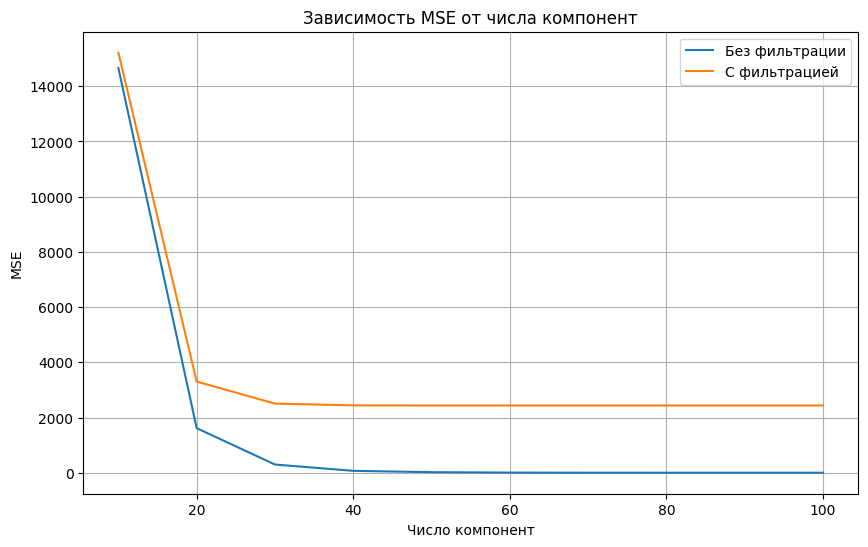

In [ ]:
from scipy.ndimage import gaussian_filter1d

# Параметры исследования
segment_length = 100
num_components_list = [10, 20, 30, 40, 50, 60, 70, 80, 90, 100]
filter_sigma = 2

mse_without_filter = []
mse_with_filter = []

for num_components in num_components_list:
    # Сжатие без фильтрации
    compressed_matrix, pca = compress_audio(mono_sound_to_cut, segment_length, num_components)
    reconstructed_signal = reconstruct_audio(compressed_matrix, pca)
    mse_without_filter.append(np.mean((mono_sound_to_cut - reconstructed_signal) ** 2))

    # Сжатие с фильтрацией
    filtered_signal = gaussian_filter1d(mono_sound_to_cut, sigma=filter_sigma)
    compressed_matrix, pca = compress_audio(filtered_signal, segment_length, num_components)
    reconstructed_signal = reconstruct_audio(compressed_matrix, pca)
    mse_with_filter.append(np.mean((mono_sound_to_cut - reconstructed_signal) ** 2))

# Построение графика
plt.figure(figsize=(10, 6))
plt.plot(num_components_list, mse_without_filter, label='Без фильтрации')
plt.plot(num_components_list, mse_with_filter, label='С фильтрацией')
plt.xlabel('Число компонент')
plt.ylabel('MSE')
plt.title('Зависимость MSE от числа компонент')
plt.legend()
plt.grid(True)
plt.show()


b) Для проведения исследования влияния степени сжатия на звук по субъективным ощущениям, можер использовать функции compress_audio и reconstruct_audio для разных значений num_components и степени сжатия, а затем сравнить восстановленный звук с оригинальным на слух.

1. С увеличением числа компонентов при сжатии, MSE восстановленного сигнала уменьшается, показывая более точное восстановление.

2. Фильтрация данных может ухудшить качество восстановления, добавляя искажения.

3. Начальные компоненты сжатия вносят ключевой вклад в восстановление, дополнительные компоненты могут содержать шум.

4. Высокое количество компонентов может привести к восстановлению шумовой информации, снижая полезность метода.

c) Степень сжатия определяется количеством главных компонент, которые остаются после применения PCA. Для большой аудиозаписи скорее всего нужно разбить ее на большее число отрезков, чтобы сохранить более мелкие детали звука. Это связано с тем, что большая аудиозапись может содержать более разнообразные звуковые события, которые требуется сохранить.

d) Степень сжатия означает, как много информации оригинального сигнала будет учтено в сжатом представлении. Более высокая степень сжатия означает, что мы сохраняем меньше информации и теряем некоторые детали. Автоматически подобрать степень сжатия можно с использованием методов объясненной дисперсии или критерия локтя, которые помогут выбрать оптимальное количество компонент для сохранения информации.